In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

In [3]:
df_data = pd.read_csv("nobk_data/data.csv")
df_data.head()

,id,f_00,f_01,f_02,f_03,f_04,f_05,f_06,f_07,f_08,...,f_19,f_20,f_21,f_22,f_23,f_24,f_25,f_26,f_27,f_28
0,0,-0.389420,-0.912791,0.648951,0.589045,-0.830817,0.733624,2.258560,2,13,...,-0.478412,-0.757002,-0.763635,-1.090369,1.142641,-0.884274,1.137896,1.309073,1.463002,0.813527
1,1,-0.689249,-0.453954,0.654175,0.995248,-1.653020,0.863810,-0.090651,2,3,...,-0.428791,-0.089908,-1.784204,-0.839474,0.459685,1.759412,-0.275422,-0.852168,0.562457,-2.680541
2,2,0.809079,0.324568,-1.170602,-0.624491,0.105448,0.783948,1.988301,5,11,...,-0.413534,-1.602377,1.190984,3.267116,-0.088322,-2.168635,-0.974989,1.335763,-1.110655,-3.630723
3,3,-0.500923,0.229049,0.264109,0.231520,0.415012,-1.221269,0.138850,6,2,...,0.619283,1.287801,0.532837,1.036631,-2.041828,1.440490,-1.900191,-0.630771,-0.050641,0.238333
4,4,-0.671268,-1.039533,-0.270155,-1.830264,-0.290108,-1.852809,0.781898,8,7,...,-1.628830,-0.434948,0.322505,0.284326,-2.438365,1.473930,-1.044684,1.602686,-0.405263,-1.987263


In [3]:
df_data.describe().T

,count,mean,std,min,25%,50%,75%,max
id,98000.0,48999.500000,28290.307527,0.000000,24499.750000,48999.500000,73499.250000,97999.000000
f_00,98000.0,0.001220,1.002801,-4.732235,-0.675226,0.002022,0.677271,4.490521
f_01,98000.0,0.005580,1.000742,-4.202795,-0.670985,0.006650,0.677746,4.324974
f_02,98000.0,-0.001042,1.001373,-4.377021,-0.672779,-0.000324,0.677086,4.560247
f_03,98000.0,-0.000700,1.000422,-4.010826,-0.672540,-0.003185,0.672097,4.399373
f_04,98000.0,-0.003522,1.003061,-4.535903,-0.682510,-0.003307,0.677589,4.050549
f_05,98000.0,-0.001612,1.000532,-4.300767,-0.675066,0.001024,0.673344,4.710316
f_06,98000.0,-0.003042,0.997434,-4.894525,-0.680421,-0.002053,0.668112,3.998595
f_07,98000.0,5.545918,3.691840,0.000000,3.000000,5.000000,8.000000,32.000000
f_08,98000.0,6.763061,4.152348,0.000000,4.000000,6.000000,9.000000,30.000000


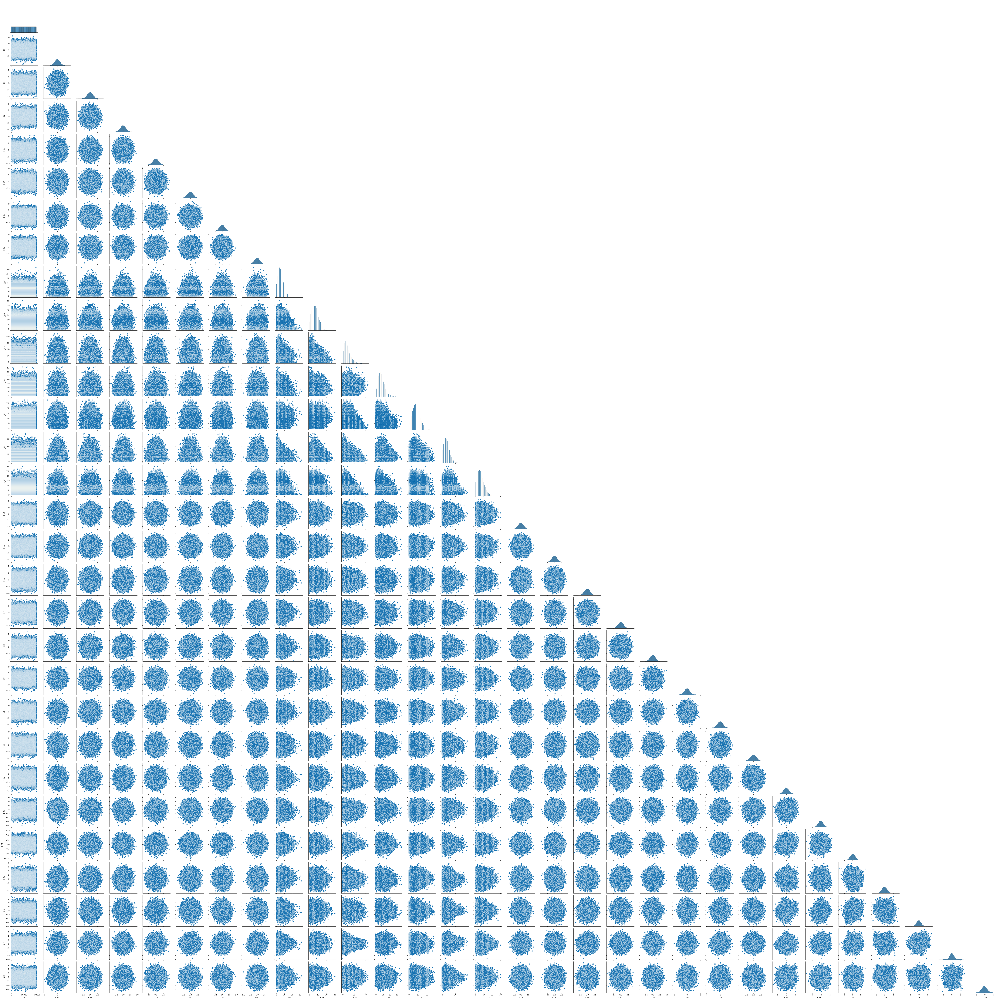

In [5]:
sns.pairplot(df_data, corner=True)

In [4]:
df_data.dtypes

id        int64
f_00    float64
f_01    float64
f_02    float64
f_03    float64
f_04    float64
f_05    float64
f_06    float64
f_07      int64
f_08      int64
f_09      int64
f_10      int64
f_11      int64
f_12      int64
f_13      int64
f_14    float64
f_15    float64
f_16    float64
f_17    float64
f_18    float64
f_19    float64
f_20    float64
f_21    float64
f_22    float64
f_23    float64
f_24    float64
f_25    float64
f_26    float64
f_27    float64
f_28    float64
dtype: object

In [5]:
int_cols = ["f_07", "f_08", "f_09", "f_10", "f_11", "f_12", "f_13"]
double_cols = list(filter(lambda col: col not in int_cols+["id"], df_data.columns))

In [6]:
from sklearn.decomposition import PCA

In [7]:
pca = PCA()
pca.fit(df_data[double_cols])

PCA()

In [8]:
pca.explained_variance_ratio_

array([0.09457675, 0.0883987 , 0.0775709 , 0.06998636, 0.06303148,
       0.05772951, 0.05429059, 0.03367072, 0.03356184, 0.03350748,
       0.0333796 , 0.03329604, 0.03305039, 0.03301708, 0.03295648,
       0.03293464, 0.03281343, 0.03272172, 0.03256271, 0.03251954,
       0.032263  , 0.03216102])

In [9]:
cumsum = np.cumsum(pca.explained_variance_ratio_)
d = np.argmax(cumsum >= 0.95) + 1

In [10]:
d

21

In [11]:
len(double_cols)

22

In [12]:
from sklearn.preprocessing import StandardScaler

In [13]:
scaler = StandardScaler()
df_double_std = pd.DataFrame(scaler.fit_transform(df_data[double_cols]), columns=double_cols)

In [14]:
from scipy.spatial.distance import pdist

pair_dist = pdist(df_data[double_cols].values)

 => MemoryError

In [15]:
N = df_data.shape[0]
n = int(N**.5)
print(N, n)
df_sample = df_data.sample(n=n)

98000 313


In [39]:
sns.pairplot(df_sample, corner=True)

In [16]:
pair_dist = pdist(df_sample[double_cols].values)

In [17]:
pair_dist.shape

(48828,)

<AxesSubplot:ylabel='Count'>

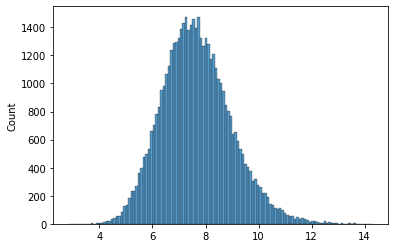

In [18]:
sns.histplot(pair_dist)

In [19]:
from sklearn.decomposition import KernelPCA


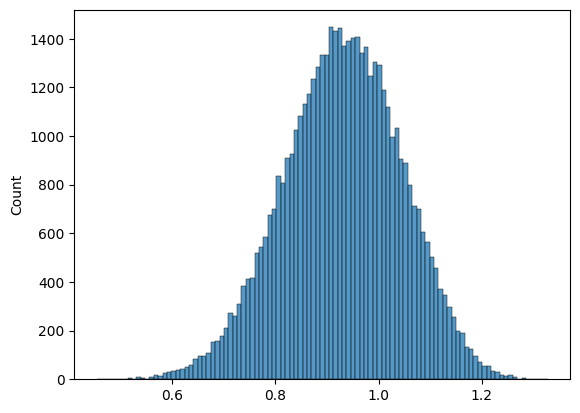

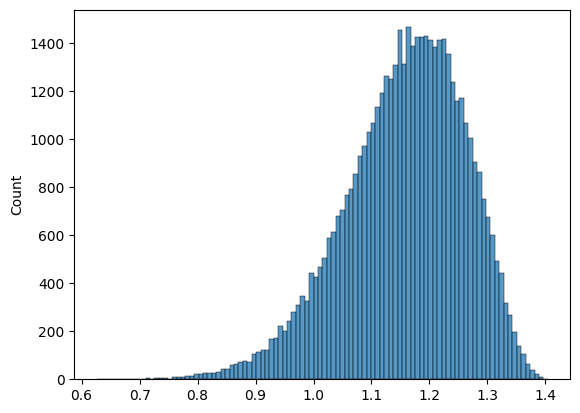

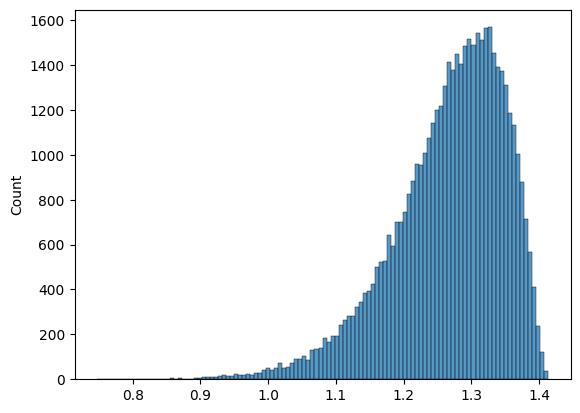

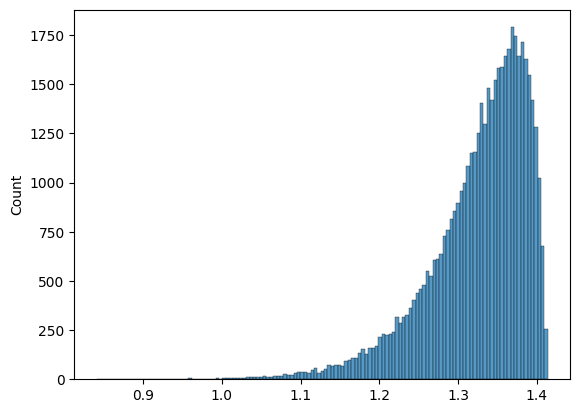

In [62]:
gs = np.arange(.01, .05, .01)
for g in gs:
  kpca = KernelPCA(kernel="rbf", gamma=g)
  kpca.fit(df_sample[double_cols])
  df_out = kpca.transform(df_sample[double_cols])
  pds = pdist(df_out)
  sns.histplot(pds)
  plt.show()

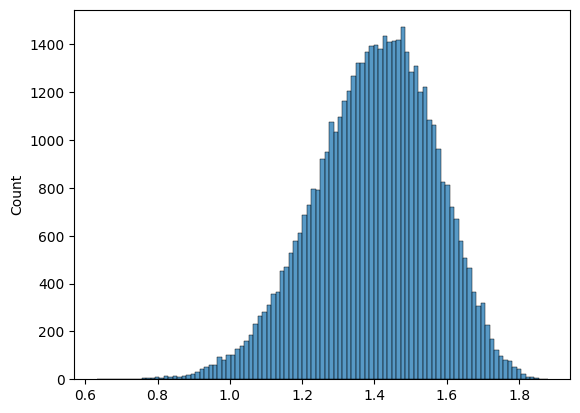

In [63]:
#gs = np.arange(.01, .05, .01)
#for g in gs:
kpca = KernelPCA(kernel="cosine")
kpca.fit(df_sample[double_cols])
df_out = kpca.transform(df_sample[double_cols])
pds = pdist(df_out)
sns.histplot(pds)
plt.show()

In [64]:
#gs = np.arange(.01, .05, .01)
#for g in gs:
kpca = KernelPCA(kernel="sigmoid")
kpca.fit(df_sample[double_cols])
df_out = kpca.transform(df_sample[double_cols])
pds = pdist(df_out)
sns.histplot(pds)
plt.show()

ValueError: There are significant negative eigenvalues (0.237136 of the maximum positive). Either the matrix is not PSD, or there was an issue while computing the eigendecomposition of the matrix.

In [20]:
centroid = df_data[double_cols].mean().values

In [21]:
centroid

array([ 0.00121967,  0.00557952, -0.00104183, -0.00070018, -0.0035219 ,
       -0.00161183, -0.0030416 ,  0.00341335, -0.00263886,  0.0054038 ,
        0.00165604, -0.00539935, -0.00451262, -0.00051539, -0.00167   ,
       -0.03875202, -0.22000225,  0.16643363, -0.06430905, -0.06253998,
        0.09847213, -0.23090999])

In [22]:
def calc_dist(row):
  p = row.values
  return np.linalg.norm(p-centroid)
dists = df_data[double_cols].apply(calc_dist, axis="columns")

<AxesSubplot:ylabel='Count'>

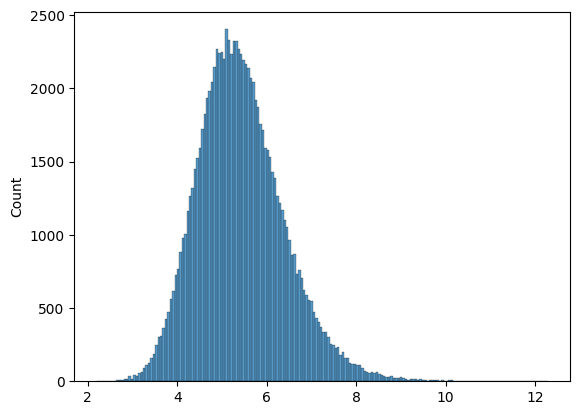

In [77]:
sns.histplot(dists)

In [23]:
def calc_angle(row):
  p = row.values
  return np.dot(p, centroid)
angles = df_data[double_cols].apply(calc_angle, axis="columns")

<AxesSubplot:ylabel='Count'>

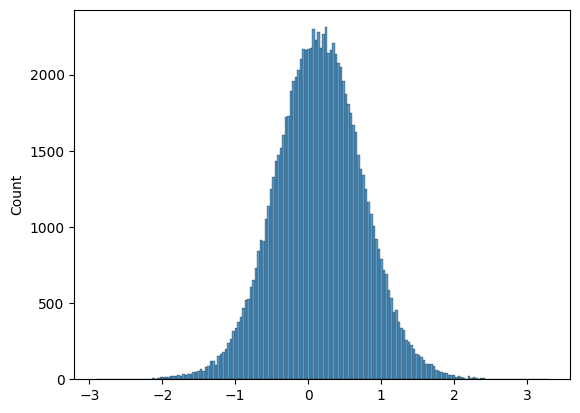

In [83]:
sns.histplot(angles)

# Int columns

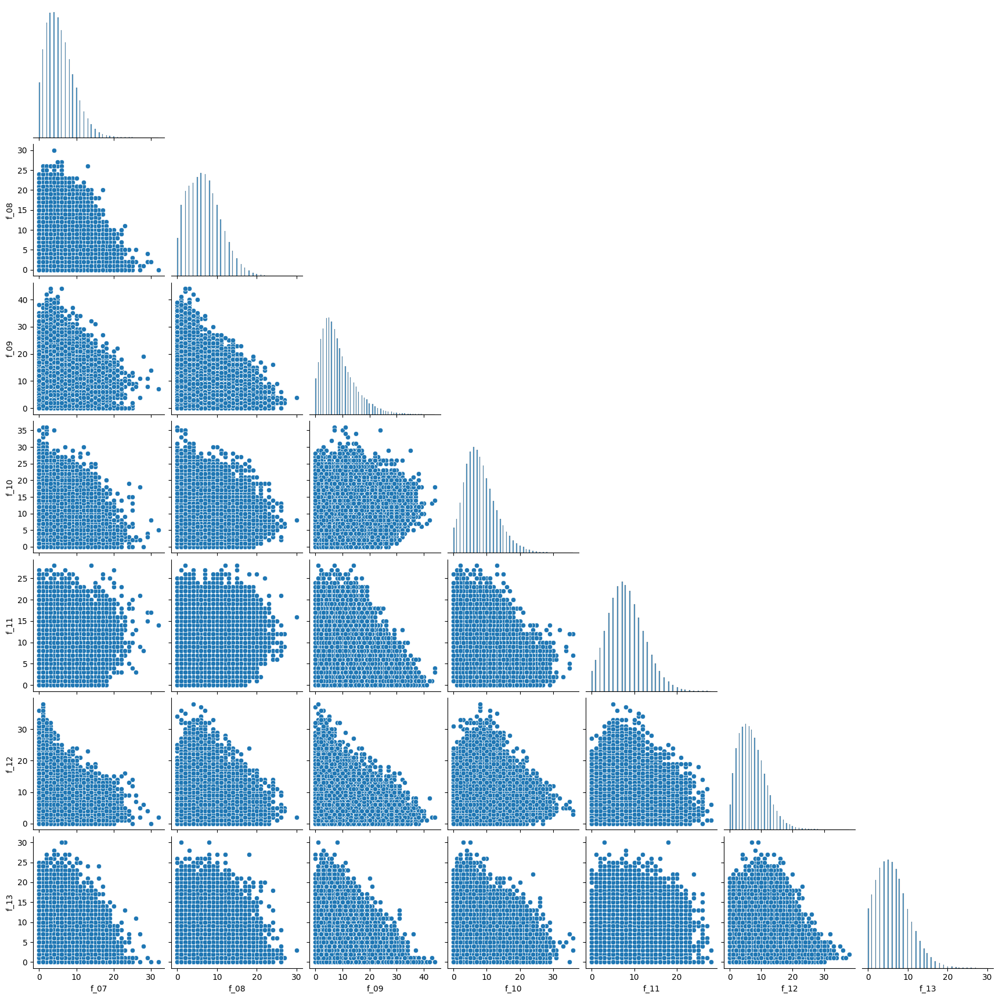

In [90]:
sns.pairplot(df_data[int_cols], corner=True)

In [24]:
int_pca = PCA().fit(df_data[int_cols])
int_pca.explained_variance_ratio_

array([0.31287998, 0.1821551 , 0.16638715, 0.10537919, 0.09536777,
       0.08823087, 0.04959992])

In [25]:
np.cumsum(int_pca.explained_variance_ratio_)

array([0.31287998, 0.49503509, 0.66142224, 0.76680143, 0.8621692 ,
       0.95040008, 1.        ])

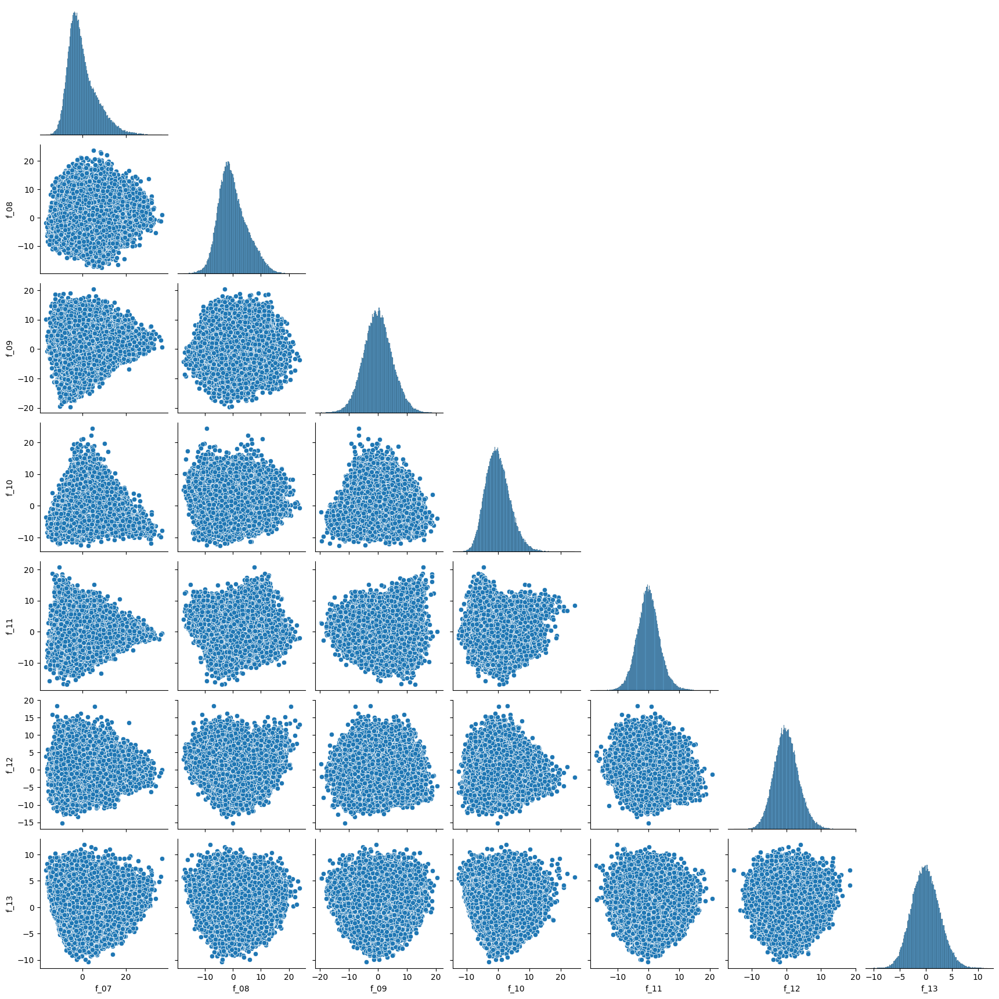

In [94]:
sns.pairplot(pd.DataFrame(int_pca.transform(df_data[int_cols]), columns=int_cols), corner=True)

In [6]:
df_data[int_cols].quantile(q=.9, axis="rows")

f_07    11.0
f_08    12.0
f_09    16.0
f_10    14.0
f_11    14.0
f_12    13.0
f_13    12.0
Name: 0.9, dtype: float64

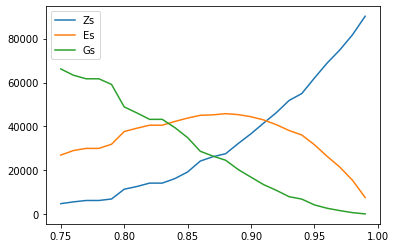

In [26]:
zs=[]
es=[]
gs=[]
qs = np.arange(.75, 1, .01)
for q in qs:
  cut = df_data[int_cols].quantile(q=q, axis="rows")

  for c in int_cols:
    df_data["c_"+c] = df_data[c] >= cut[c]
  c_int_cols = ["c_"+c for c in int_cols]
  zs.append((df_data[c_int_cols].sum(axis="columns")<1).sum())
  es.append((df_data[c_int_cols].sum(axis="columns")==1).sum())
  gs.append((df_data[c_int_cols].sum(axis="columns")>1).sum())
plt.plot(qs, zs, label="Zs")
plt.plot(qs, es, label="Es")
plt.plot(qs, gs, label="Gs")
plt.legend()

In [28]:
qs[np.argmax(es)]

0.8800000000000001

In [30]:
cut = df_data[int_cols].quantile(q=.88, axis="rows").values
def predict(row):
  return np.argmax(row.values-cut)
df_data["Predicted"] = df_data[int_cols].apply(predict, axis="columns")
df_data[["id", "Predicted"]].to_csv("sub_1.csv", index=False)